In [2]:
import pandas as pd;
import numpy as np;
import matplotlib.pyplot as plt;
import seaborn as sns;
%matplotlib inline  


In [3]:
# ran from the root directory of the project folder from the zip file provided 
import os;
cwd = os.getcwd()
print(cwd)

/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data


In [4]:
#find the files for all users for groundTruth and the myoData that will be read into pandas via pd.read_csv()


def GetFilePath(cwd):
    emg=[]
    groundTruth=[]
    imu=[]
    
    for dirName, subdirList, fileList in os.walk(cwd):

        if 'Truth' in dirName and len(fileList)>0 and 'txt' in fileList[0]:
            groundTruth.append(dirName+'/'+fileList[0])

        MyoData=[(dirName,file) for file in fileList if 'EMG' in file]

        for f in MyoData:

            emg.append(f[0]+'/'+f[1])

        MyoData=[(dirName,file) for file in fileList if 'IMU' in file]

        for f in MyoData:

            imu.append(f[0]+'/'+f[1])
    return emg, groundTruth, imu
    
emg, groundTruth, imu= GetFilePath(cwd)

       
print('This is emg folders')
print('\n')
print(emg)
print('\n')
print('This is imu folders')
print('\n')
print(imu)
print('\n')
print('this is groundTruth')
print('\n')
print(groundTruth)
 
#since there are 30 users with both fork and spoon data we want to see each of our lists contain 60 samples. 
print(len(groundTruth))        
print(len(emg))
print(len(imu))

     

    


This is emg folders


['/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user39/fork/1503955687111_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user39/spoon/1503954634592_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user37/fork/1503945980566_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user37/spoon/1503945515116_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user30/fork/1503697313323_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user30/spoon/1503696689988_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user31/fork/1503698678322_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user31/spoon/1503699291032_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Data/MyoData/user09/fork/1503510449718_EMG.txt', '/Users/owner/Desktop/asu/cse_572/Data_Mining_Assign1Da

In [5]:

def indexingFilePath(groundTruth,emg):
    user_idx_groundTruth=[]
    user_idx_myo=[]
    matches=[]
    
    for i in range(len(groundTruth)):
        user_idx_groundTruth.append(groundTruth[i].split('/')[-3:-1])

        user_idx_myo.append(emg[i].split('/')[-3:-1])
    for i in range(len(user_idx_myo)):
        if user_idx_myo[i][0]=='user09':
            user_idx_myo[i][0]='user9'



    for i in range(len(user_idx_groundTruth)):

        for j in range (len(user_idx_myo)):

            if user_idx_groundTruth[i]==user_idx_myo[j]:
                matches.append((user_idx_groundTruth[i][0],user_idx_groundTruth[i][1],i,j))
    return matches

matches=indexingFilePath(groundTruth,emg)

print(len(matches))
print(matches)
#confirmed that there are 60 matches for the 30 users grundtruth and myo data from both spoon and fork
# had to change user 09 in myo data to user9 so that we could get an idx match
# have the idx of where the corresponding files from groundtruth and myo data match from our list of files
# confirmed that imu_matches is equal to emg_matches


60
[('user39', 'fork', 0, 0), ('user39', 'spoon', 1, 1), ('user37', 'fork', 2, 2), ('user37', 'spoon', 3, 3), ('user30', 'fork', 4, 4), ('user30', 'spoon', 5, 5), ('user31', 'fork', 6, 6), ('user31', 'spoon', 7, 7), ('user36', 'fork', 8, 10), ('user36', 'spoon', 9, 11), ('user38', 'fork', 10, 12), ('user38', 'spoon', 11, 13), ('user25', 'fork', 12, 14), ('user25', 'spoon', 13, 15), ('user22', 'fork', 14, 16), ('user22', 'spoon', 15, 17), ('user14', 'fork', 16, 18), ('user14', 'spoon', 17, 19), ('user13', 'fork', 18, 20), ('user13', 'spoon', 19, 21), ('user40', 'fork', 20, 22), ('user40', 'spoon', 21, 23), ('user12', 'fork', 22, 24), ('user12', 'spoon', 23, 25), ('user23', 'fork', 24, 26), ('user23', 'spoon', 25, 27), ('user24', 'fork', 26, 28), ('user24', 'spoon', 27, 29), ('user41', 'fork', 28, 30), ('user41', 'spoon', 29, 31), ('user33', 'fork', 30, 32), ('user33', 'spoon', 31, 33), ('user34', 'fork', 32, 34), ('user34', 'spoon', 33, 35), ('user32', 'fork', 34, 36), ('user32', 'spoon

In [6]:
imu_match= indexingFilePath(groundTruth,imu)
imu_match==matches

True

In [17]:

#matches tupes are in the format('user_id',spoon/fork,groundtruth_file_idx,myo_file_idx)
# these are going to be used so that we can create a dict[userid_utensiltype]=groundtruth_df

def CreateGroundTruthDict(matches):
    groundTruth_dict={}
    groundTruth_col_names=['Start','End','unknown']
    for item in matches:

        user_id,user_utensil,groundTruth_idx,myo_idx =item
        df_name=user_id+'_'+user_utensil


        df=pd.read_csv(groundTruth[groundTruth_idx],
                       names=groundTruth_col_names)


        groundTruth_dict[df_name]=df

    # there was an error in user19_spoon data there was a ' ' instead of ',' so I was unable to do 100/30 and then
    # make then round and make it type int64
    groundTruth_dict['user19_spoon'].iloc[4,:]=[771,794,1]
    groundTruth_dict['user19_spoon']=groundTruth_dict['user19_spoon'].astype('int64')


    # multiply start and end rows by 100/30 so that you obtain the sample rows. Since python is 0
    # based so we also need to subtract 1 off this number to get the proper starting and ending rows indexes
    # if we were working in matlab we would not need to do this as it is 1 based. 

    for df in groundTruth_dict.values():
        df['Start']=df['Start']*100/30-1
        df['Start']=df['Start'].round()
        df['Start']=df['Start'].astype('int32')

        df['End']=df['End']*100/30
        df['End']=df['End'].round()
        df['End']=df['End'].astype('int32')
    return groundTruth_dict


groundTruth_dict=CreateGroundTruthDict(matches)

# since we are using python we want the row numbers to be (797,930)->(796,930) which we have achieved 
# I dont believe that changing the sample by 1 row will effect our seperation regardless. by not changing the 
# stop idx by 1 we have still achieved the same thing since our idx slices will only go up to 929
groundTruth_dict['user9_fork'].head(1)


,Start,End,unknown
0,796,930,2


In [8]:
def CreateUserDict(file_list,matches,col_names):
    user_dict={}
    for item in matches:
        user_id,user_utensil,groundTruth_idx,myo_idx =item
        df_name=user_id+'_'+user_utensil
        df=pd.read_csv(file_list[myo_idx],names=col_names)
        user_dict[df_name]=df
    return user_dict

    

In [10]:
#create a dict[userid_utensiltype]=groundtruth_df

emg_col_names=['timestamp','EMG1','EMG2','EMG3','EMG4','EMG5','EMG6','EMG7','EMG8']
imu_col_names=['timestamp', 'Orientation X', 'Orientation Y', 'Orientation Z', 
               'Orientation W', 'Accelerometer X', 'Accelerometer Y', 'Accelerometer Z', 
               'Gyroscope X', 'Gyroscope Y','Gyroscope Z']

emg_dict=CreateUserDict(emg,matches,emg_col_names)
imu_dict=CreateUserDict(imu,matches,imu_col_names)



In [11]:
#function to put a users actions into either eating or non-eating catagory
def findActionsUser(groundTruth,myo,col_names):
    eating=pd.DataFrame(columns=col_names)
    non_eating=pd.DataFrame(columns=col_names)
    start_eating_idx=0
    stop_eating_idx=0
    
    for i in range(len(groundTruth)-1): 
        start_eating_idx=groundTruth.loc[i, "Start"]
        stop_eating_idx=groundTruth.loc[i, "End"]
        next_start_eating_idx=groundTruth.loc[i+1, "Start"]
        next_stop_eating_idx=groundTruth.loc[i+1, "End"]
        
        #print(start_eating_idx,stop_eating_idx)

        eating=eating.append(myo.iloc[start_eating_idx:stop_eating_idx,:])
        if i==0:
            non_eating=non_eating.append(myo.iloc[:start_eating_idx,:])
        else:
            non_eating=non_eating.append(myo.iloc[stop_eating_idx:next_start_eating_idx,:])
            
        #print(eating)
        #print(non_eating)
    eating=eating.append(myo.iloc[next_start_eating_idx:next_stop_eating_idx,:])
    non_eating=non_eating.append(myo.iloc[next_stop_eating_idx:,:])
    
    return eating, non_eating




In [12]:

def getAllActions(groundTruth_dict,myo_dict,col_names,random_sampling=True):
    eating=pd.DataFrame(columns=col_names)
    non_eating=pd.DataFrame(columns=col_names)
    user_action_dict={}
    for user_id,df in groundTruth_dict.items():

    
        eat_user,not_eat_user=findActionsUser(groundTruth_dict[user_id],myo_dict[user_id],col_names)
        #print(user_id)
        #create a dict with individual user actions 

        
        eat_user['class']='eat'
        not_eat_user['class']='not_eat'


        eating=eating.append(eat_user, sort=True)
        if random_sampling:
            non_eating=non_eating.append(not_eat_user.sample(len(eat_user),random_state=10),sort=True)
            user_action_dict[user_id]=[eat_user,not_eat_user.sample(len(eat_user),random_state=10)]
            
            
        else:
            non_eating=non_eating.append(not_eat_user, sort=True)
            user_action_dict[user_id]=[eat_user,not_eat_user]
           
                
    return eating,non_eating,user_action_dict


eat_emg,not_eat_emg,emg_action_dict=getAllActions(groundTruth_dict,emg_dict,emg_col_names)
eat_imu,not_eat_imu,imu_action_dict=getAllActions(groundTruth_dict,imu_dict,imu_col_names)





In [13]:
# reset indexes of all individual users actions as well as the emg and imu eat/not_eat dataframes

def reset_index(m):
    rang=range(0,len(m))
    m.index.name = None
    m.index=rang
    return

reset_index(eat_emg)
reset_index(not_eat_emg)
reset_index(eat_imu)
reset_index(not_eat_imu)

for k in emg_action_dict.keys():
    reset_index(emg_action_dict[k][0])
    reset_index(emg_action_dict[k][1])
    reset_index(imu_action_dict[k][0])
    reset_index(imu_action_dict[k][1])
    
  


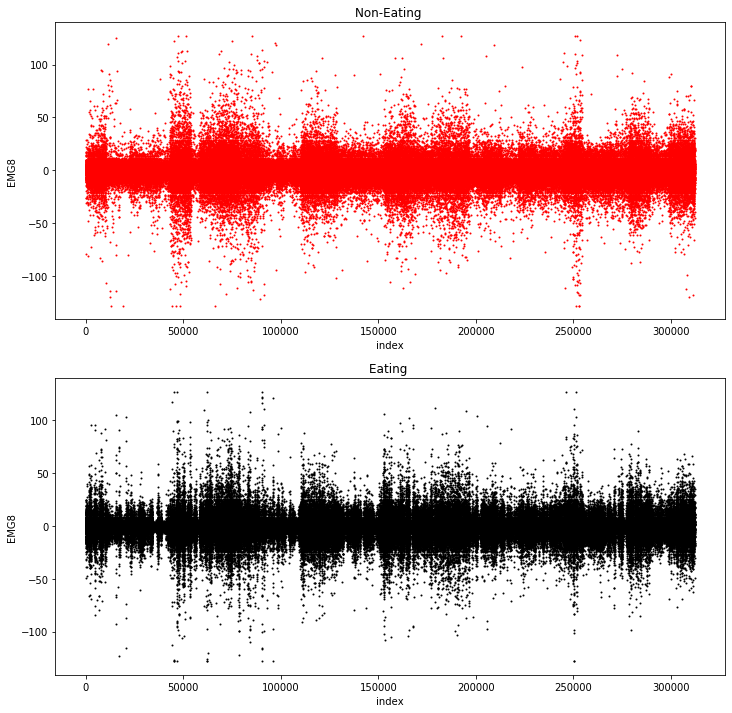

In [14]:
    fig,axes=plt.subplots(nrows=2,figsize=(12,12))
    axes[0].scatter(not_eat_emg.index,not_eat_emg.EMG8,s=1, color='r')
    axes[1].scatter(eat_emg.index,eat_emg.EMG8,s=1, color='k')
    
    axes[0].set(xlabel="index",ylabel='EMG8')
    axes[1].set(xlabel="index",ylabel='EMG8')
    axes[0].set_title('Non-Eating ')
    axes[1].set_title('Eating ')
    plt.show()

In [20]:
def eat_not_eat_emg_statistics(eat,not_eat):
    
    not_eat_feat=not_eat.iloc[:,1:-2]
    not_eat_statistics=pd.DataFrame()
    not_eat_statistics['mean'] = not_eat_feat.mean(axis=1)
    not_eat_statistics['rms'] =np.mean((not_eat_feat.iloc[:,:]**2),axis=1).pow(1/2)
    not_eat_statistics['std']=not_eat_feat.std(axis=1)
    not_eat_statistics['max']=not_eat_feat.max(axis=1)
    not_eat_statistics['min']=not_eat_feat.min(axis=1)
    not_eat_statistics['range']=not_eat_feat.max(axis=1)-not_eat_feat.min(axis=1)
    not_eat_statistics['variance']=not_eat_feat.var(axis=1)
    not_eat_statistics['cumsum']=not_eat_feat.abs().sum(axis=1)
    not_eat_statistics['eucladian norm']=np.sqrt(np.square(not_eat_feat).sum(axis=1))
    
    
    eat_feat=eat.iloc[:,1:-2]
    eat_statistics=pd.DataFrame()
    eat_statistics['mean'] = eat_feat.mean(axis=1)
    eat_statistics['rms'] = np.mean((eat_feat.iloc[:,:]**2),axis=1).pow(1/2)
    eat_statistics['std']=eat_feat.std(axis=1)
    eat_statistics['max']=eat_feat.max(axis=1)
    eat_statistics['min']=eat_feat.min(axis=1)
    eat_statistics['range']=eat_feat.max(axis=1)-eat_feat.min(axis=1)
    eat_statistics['variance']=eat_feat.var(axis=1)
    eat_statistics['cumsum']=eat_feat.abs().sum(axis=1)
    eat_statistics['eucladian norm']=np.sqrt(np.square(eat_feat).sum(axis=1))
    
    
    
    return eat_statistics, not_eat_statistics

emg_eat_feature_matrix,emg_not_eat_feature_matrix=eat_not_eat_emg_statistics(eat_emg,not_eat_emg)
imu_eat_feature_matrix,imu_not_eat_feature_matrix=eat_not_eat_emg_statistics(eat_imu,not_eat_imu)

In [22]:
# creating dictionarys containing each users statistical_feature_matrix of [eating,non_eating]

emg_action_dict_feature_matrix={}
imu_action_dict_feature_matrix={}

for k in emg_action_dict.keys():
    emg_eat,emg_no_eat=eat_not_eat_emg_statistics(emg_action_dict[k][0],emg_action_dict[k][1])
    emg_action_dict_feature_matrix[k]=[emg_eat,emg_no_eat]
    
    imu_eat,imu_no_eat=eat_not_eat_emg_statistics(imu_action_dict[k][0],imu_action_dict[k][1])
    imu_action_dict_feature_matrix[k]=[imu_eat,imu_no_eat]
imu_action_dict_feature_matrix
  

{'user39_fork': [          mean        rms        std     max     min   range    variance  \
  0     0.630000   2.290513   2.335753   6.188  -2.625   8.813    5.455743   
  1     1.082667   1.942074   1.710094   5.000  -0.420   5.420    2.924422   
  2     2.065667   3.967287   3.592553   9.562  -0.445  10.007   12.906438   
  3     3.332778   6.862550   6.362829  17.938  -0.454  18.392   40.485590   
  4     4.011333   8.410567   7.840771  22.250  -0.459  22.709   61.477689   
  ...        ...        ...        ...     ...     ...     ...         ...   
  1260 -4.137000   9.458050   9.021221   0.937 -22.812  23.749   81.382432   
  1261 -4.273778   9.839406   9.400390   0.893 -24.562  25.455   88.367333   
  1262 -3.743778   9.072241   8.765038   0.851 -24.688  25.539   76.825891   
  1263 -3.896889   9.732896   9.459728   0.885 -27.375  28.260   89.486463   
  1264 -4.130556  10.336420  10.050005   0.917 -29.188  30.105  101.002597   
  
        cumsum  eucladian norm  
  0     12.12

In [50]:
def plottingFeatures(df1,df2, username=''):
    for col in range(df1.shape[1]):
        fig,axes=plt.subplots(nrows=2,figsize=(12,12))
        axes[0].scatter(df2.index,df2.iloc[:,col],s=1, color='r')
        axes[1].scatter(df1.index,df1.iloc[:,col],s=1, color='k')

        axes[0].set(xlabel="index",ylabel=df1.columns[col])
        axes[1].set(xlabel="index",ylabel=df1.columns[col])


        #axes[0].legend([' NOT- EATING'])
        #axes[1].legend([' EATING'])
        axes[0].set_title(username+ ' Non-Eating '+ df1.columns[col]+' Row-wise')
        axes[1].set_title(username+' Eating '+ df1.columns[col]+' Row-wise')

        plt.show()

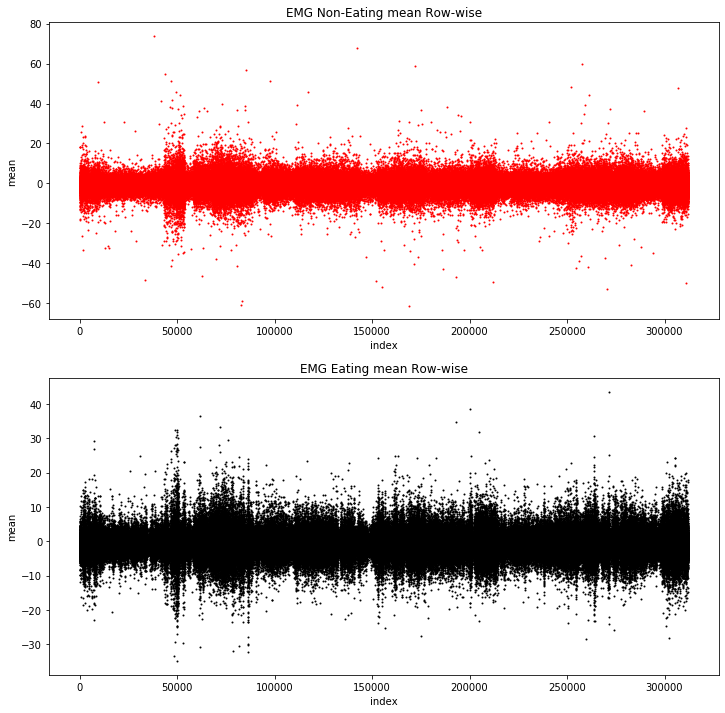

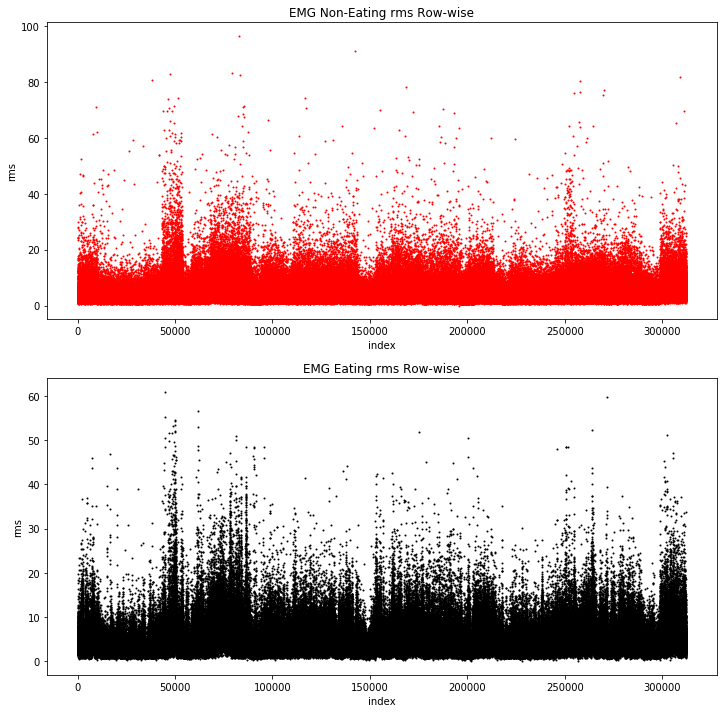

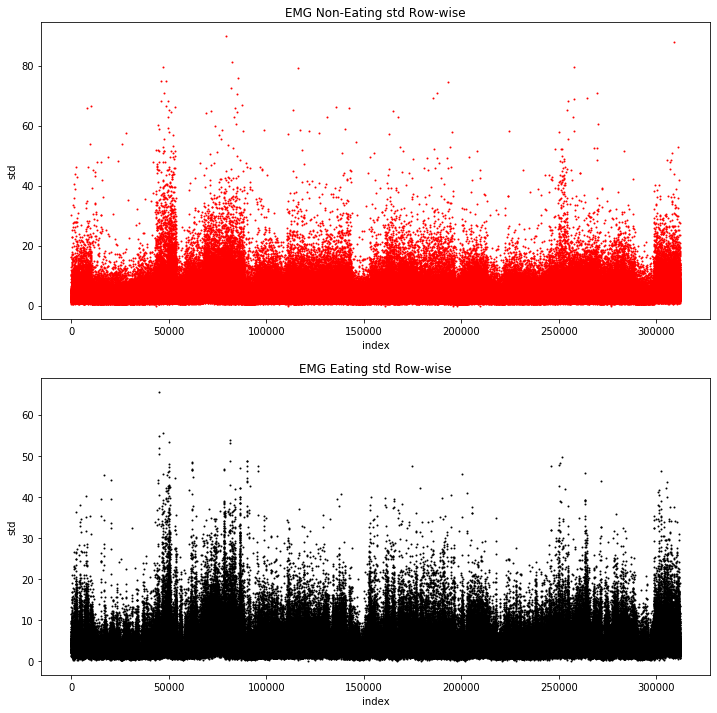

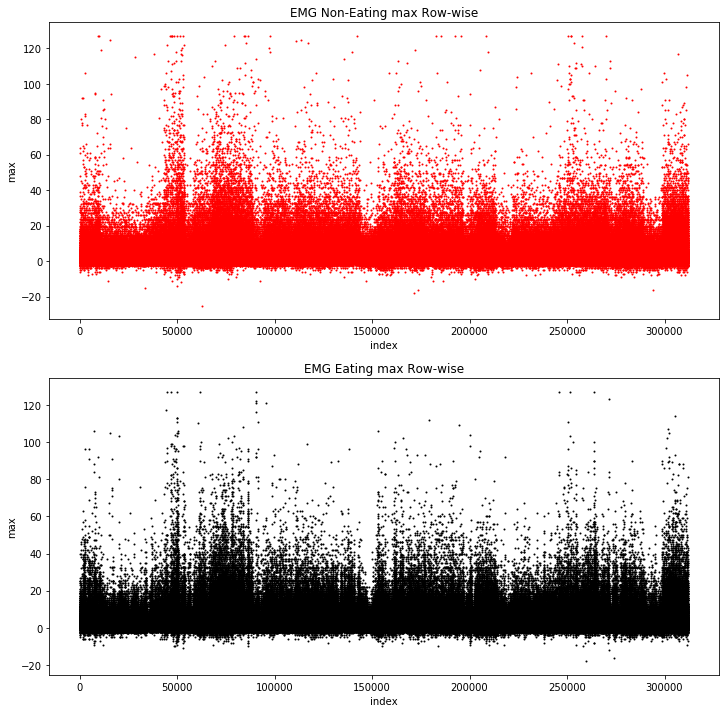

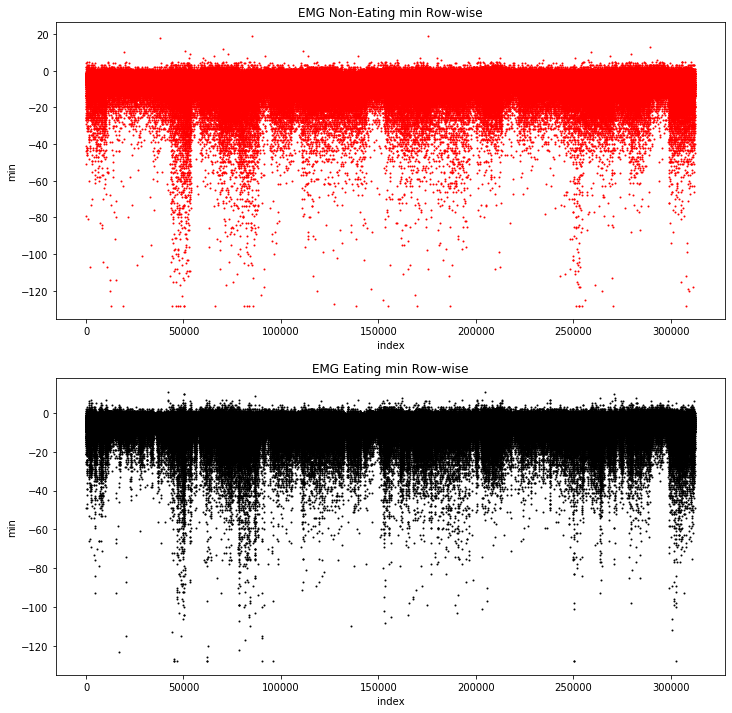

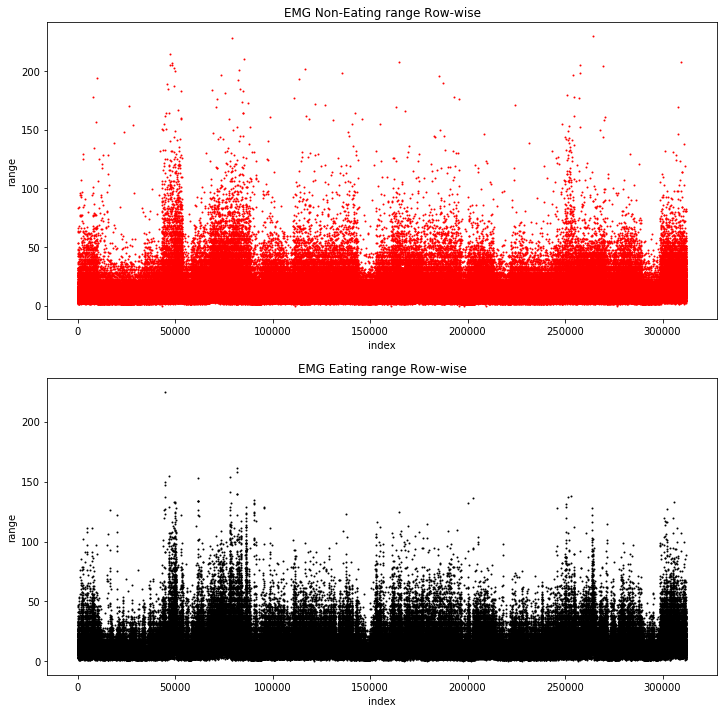

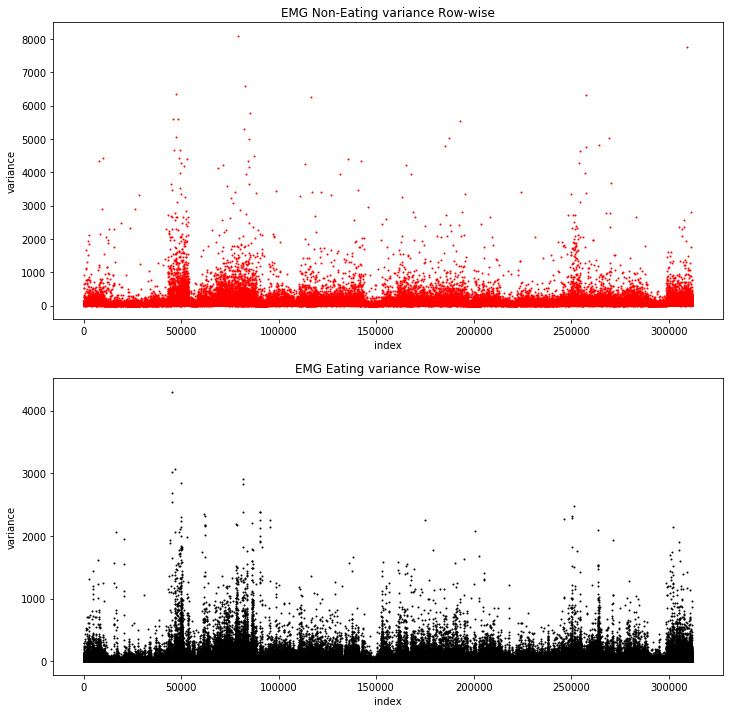

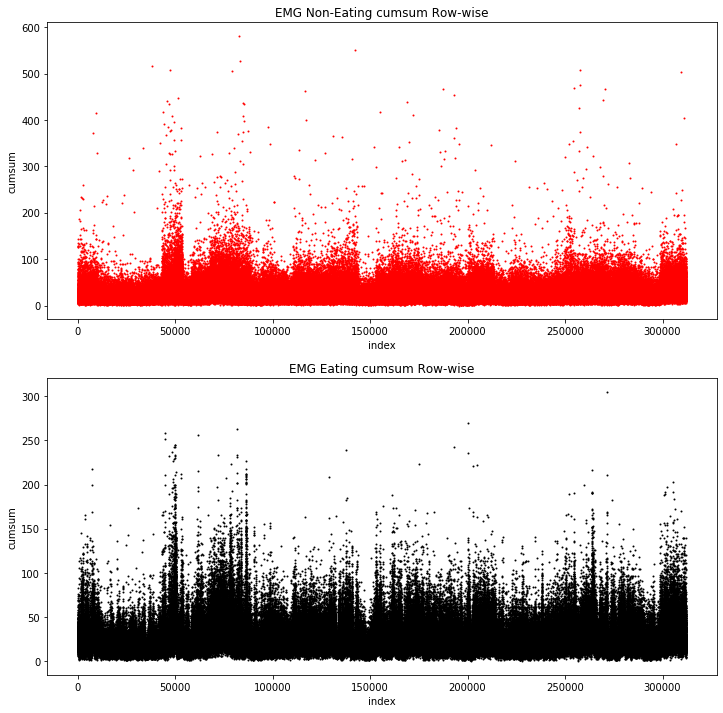

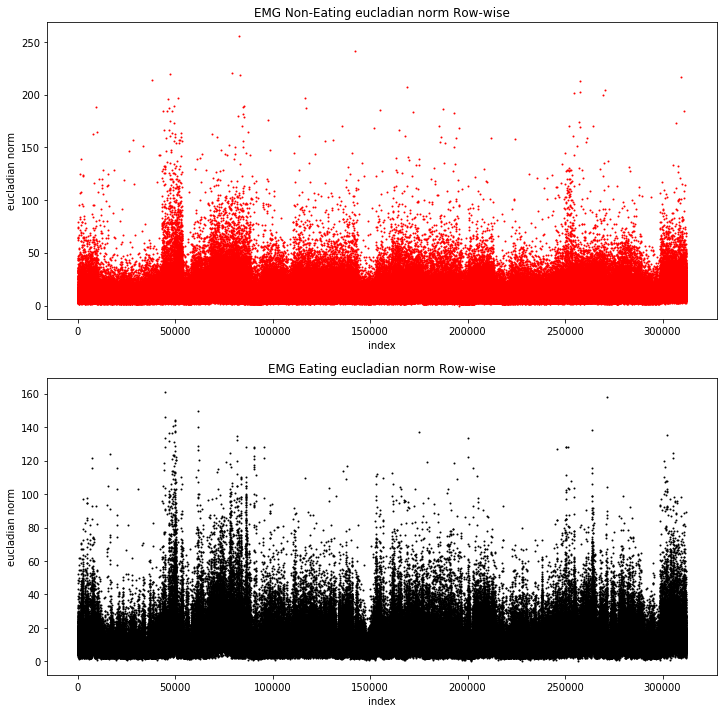

In [52]:
plottingFeatures(emg_eat_feature_matrix,emg_not_eat_feature_matrix, 'EMG')

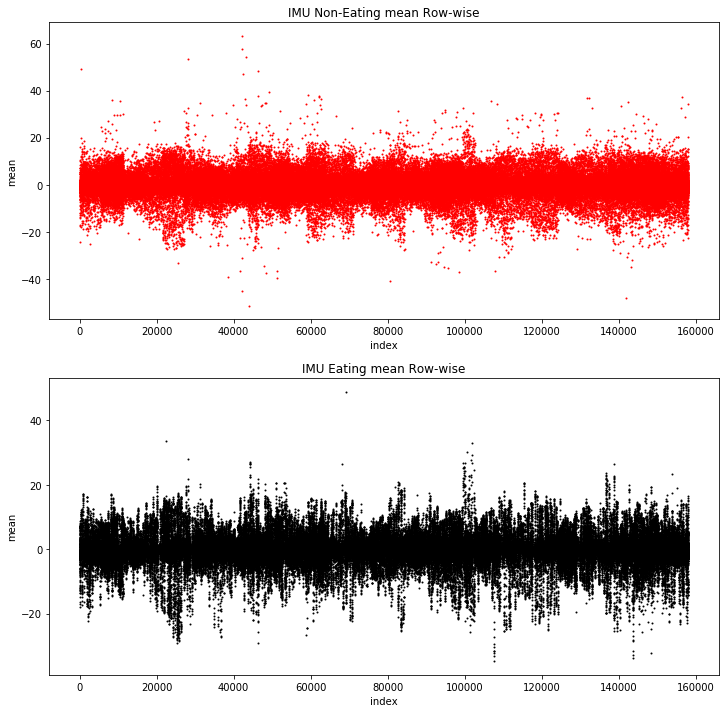

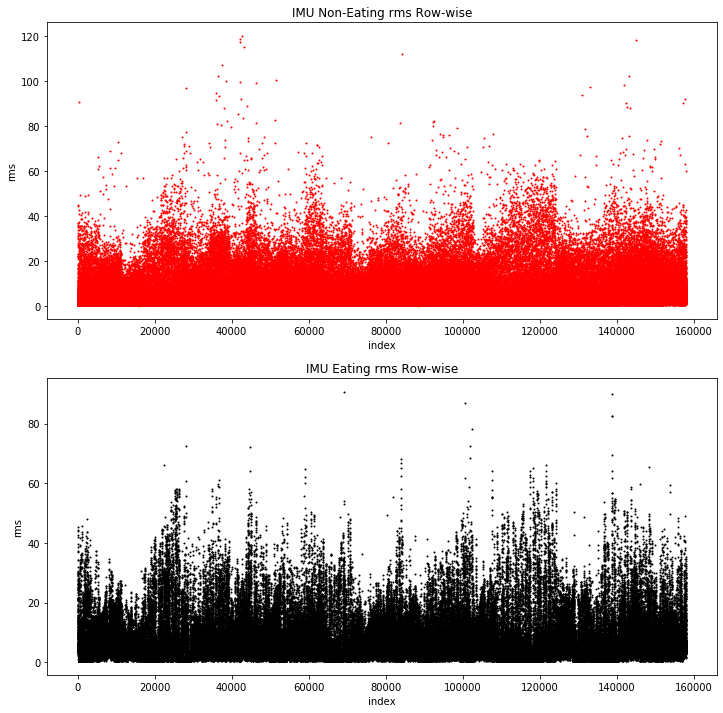

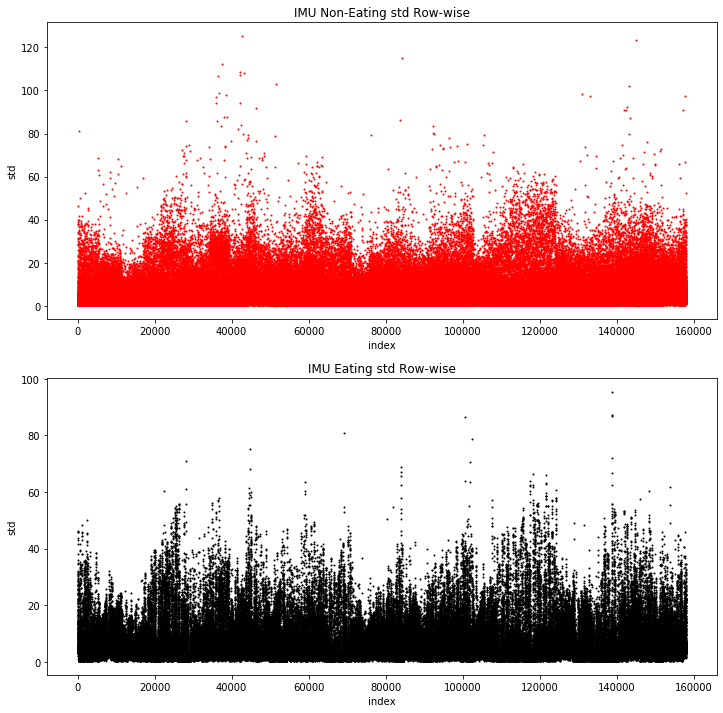

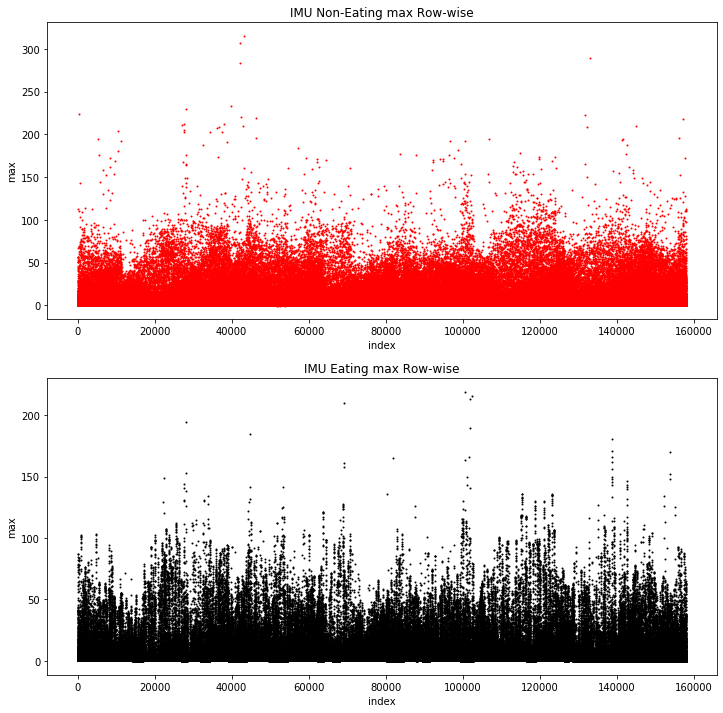

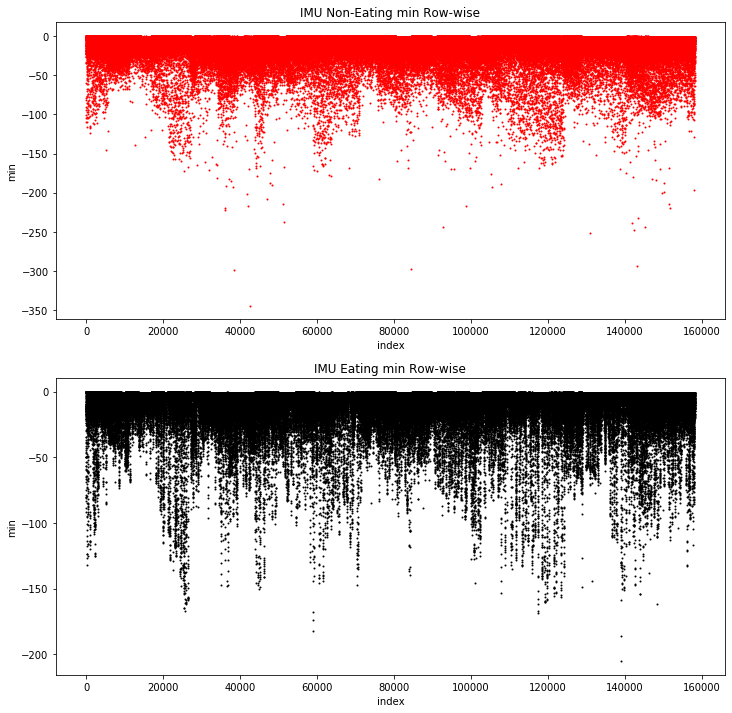

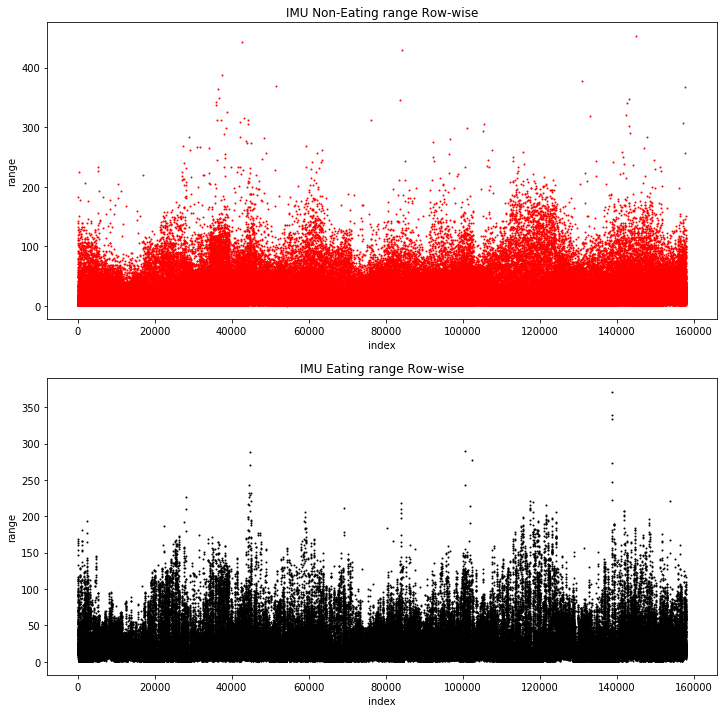

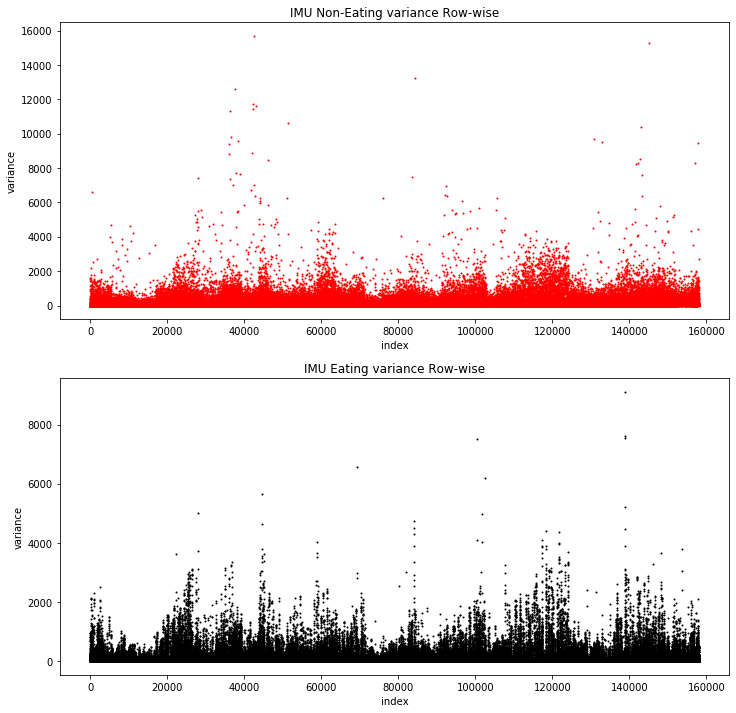

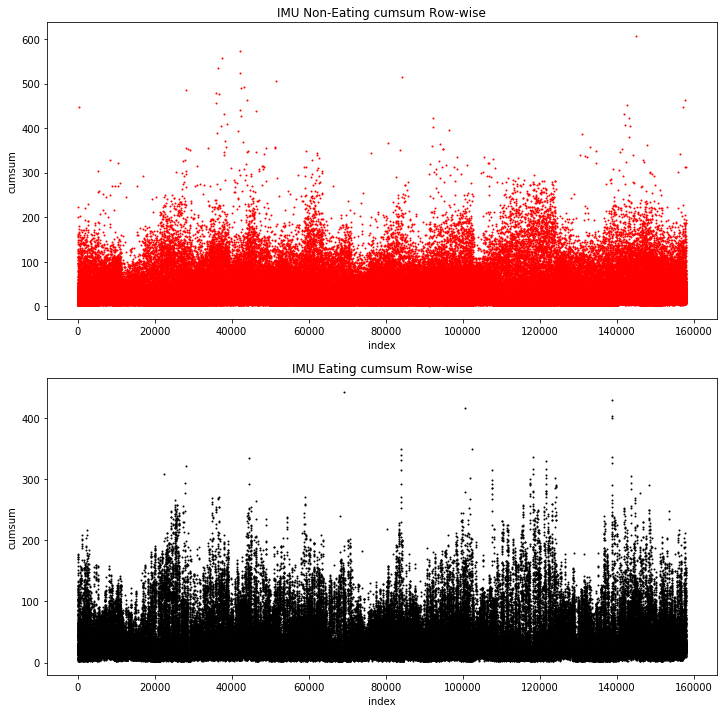

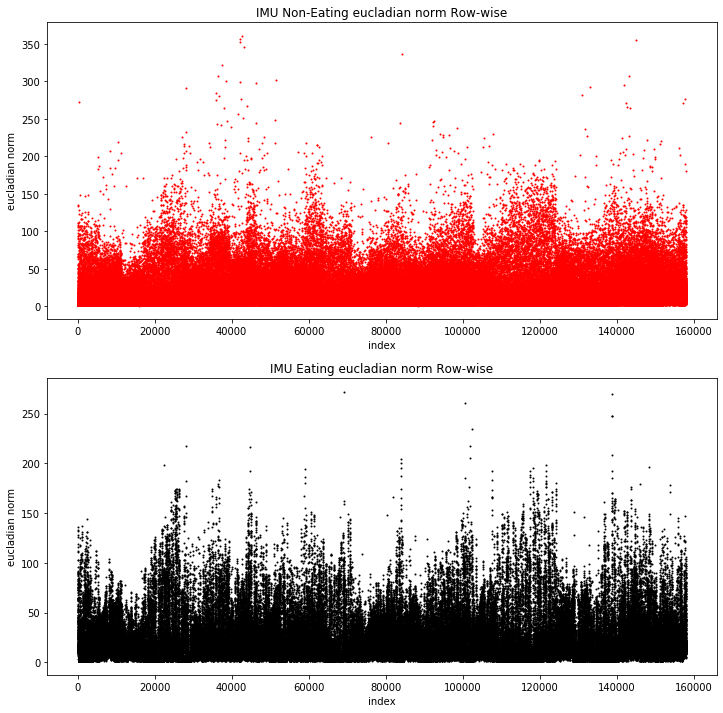

In [53]:
plottingFeatures(imu_eat_feature_matrix,imu_not_eat_feature_matrix, 'IMU')

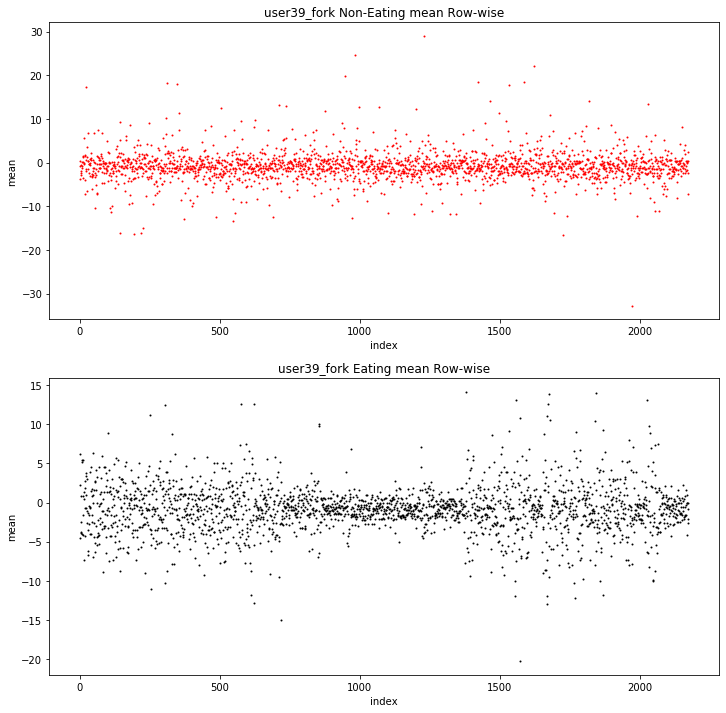

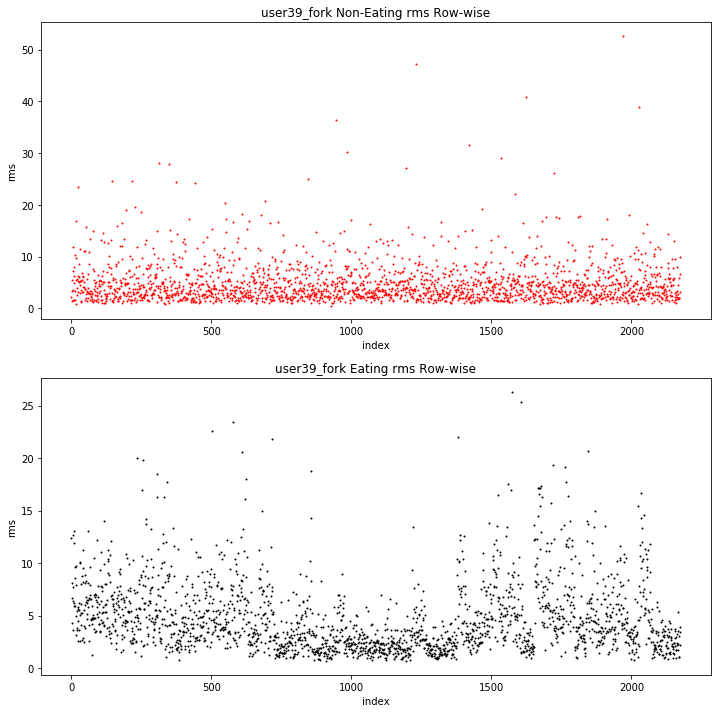

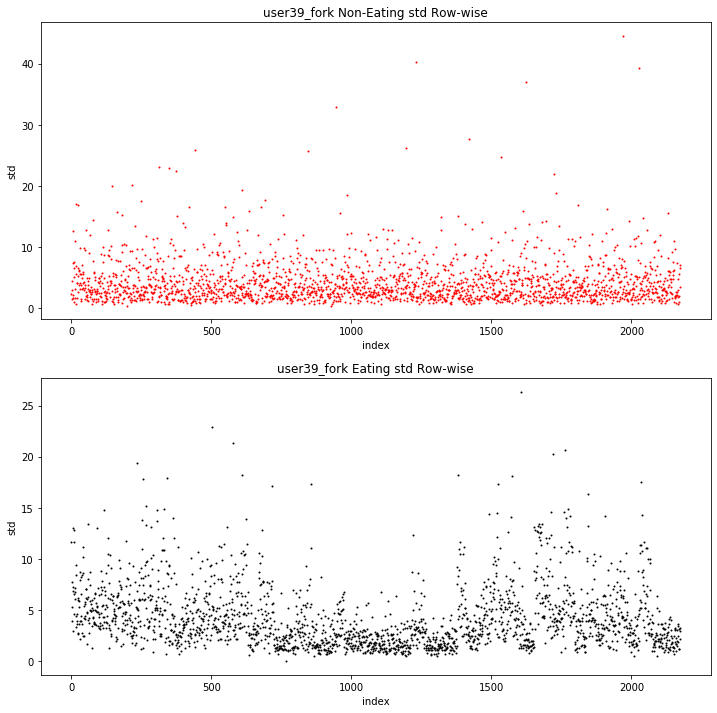

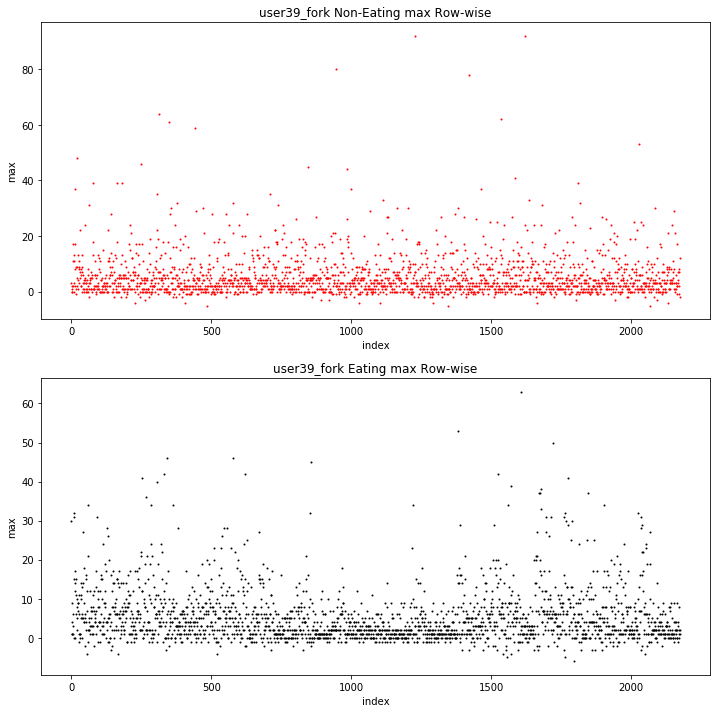

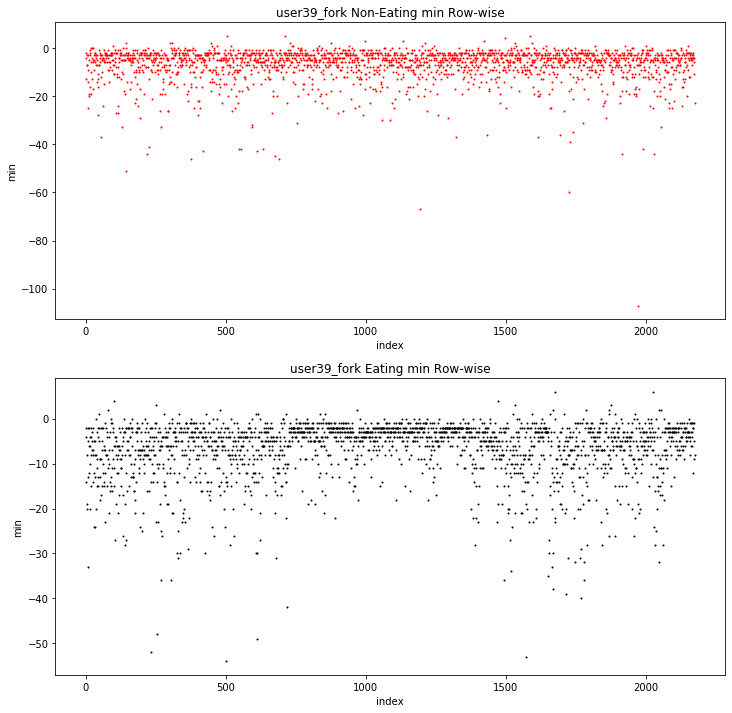

...

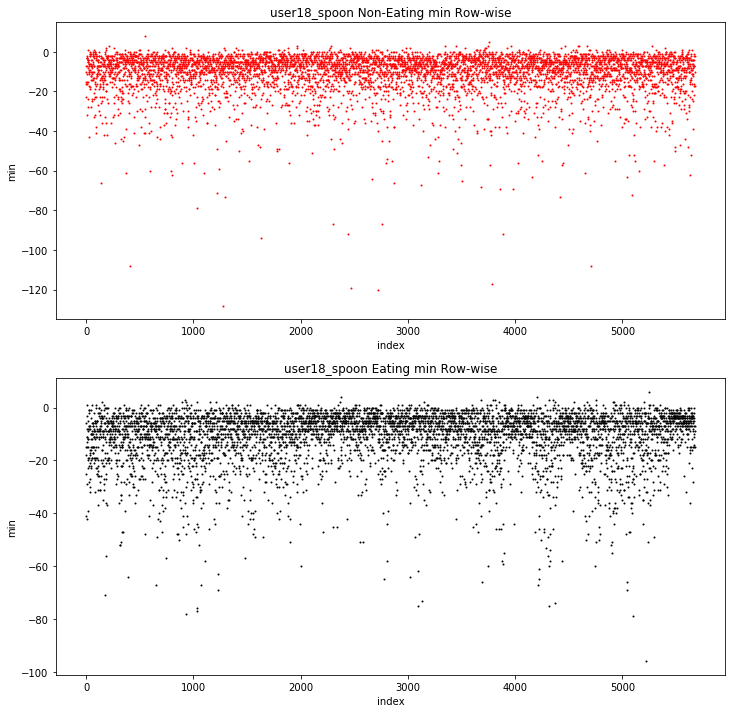

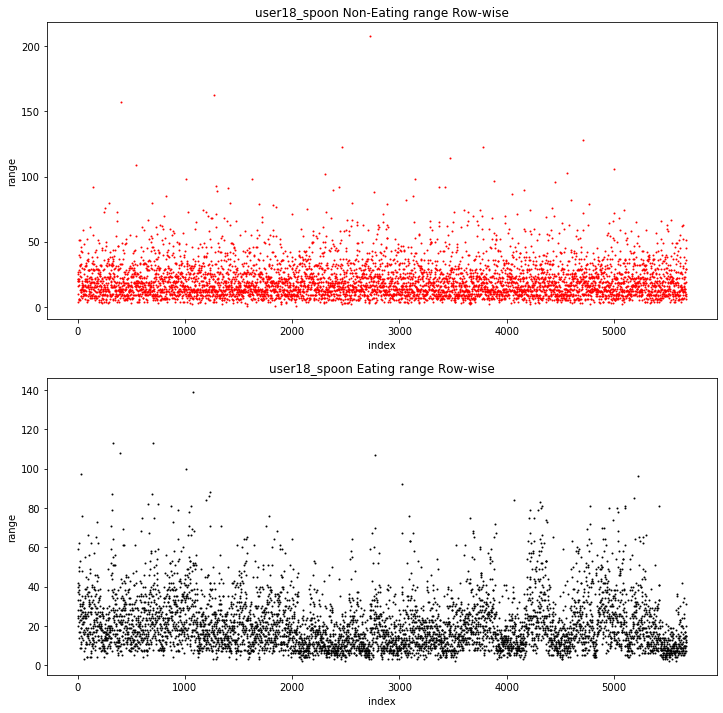

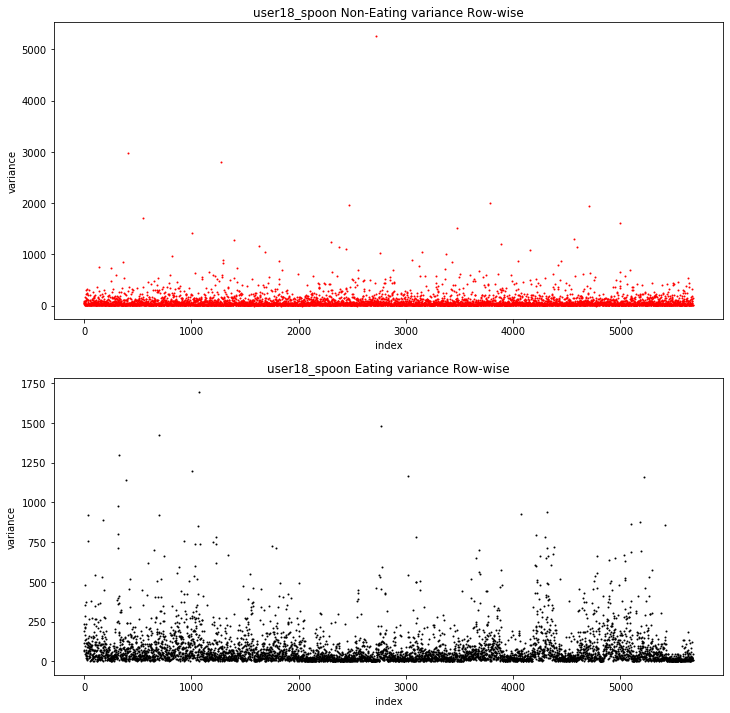

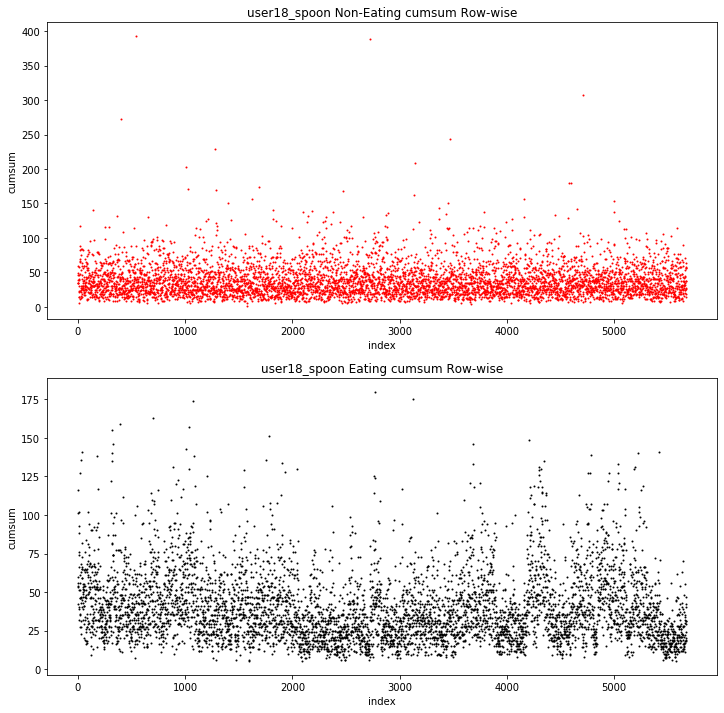

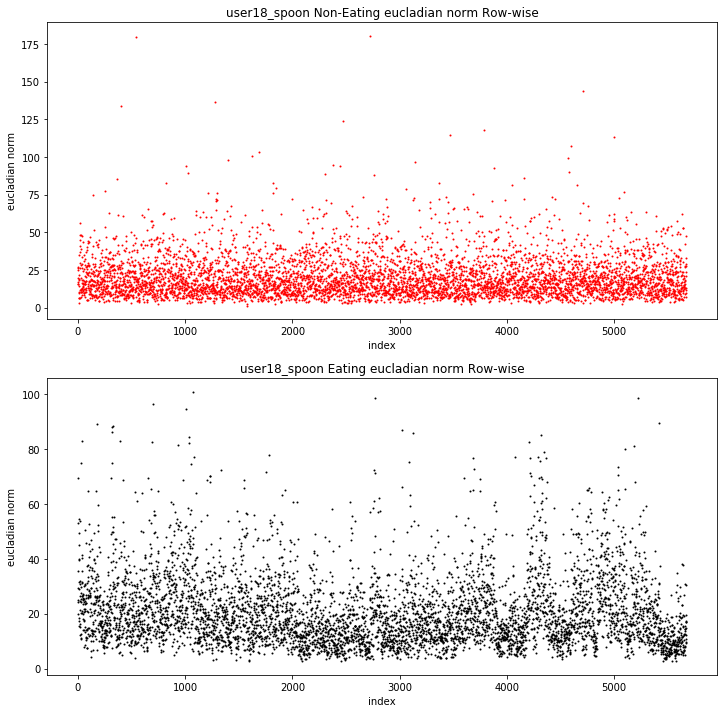

In [55]:
emg_action_dict_feature_matrix
for k,v in emg_action_dict_feature_matrix.items():
    eat=emg_action_dict_feature_matrix[k][0]
    not_eat=emg_action_dict_feature_matrix[k][1]
    plottingFeatures(eat,not_eat,k)


In [23]:
# create a matrix containing the labels to be added onto after pca. and create the combined
# emg matrix without class labels for pca 

emg_eat_feature_matrix['class']='eat'
emg_not_eat_feature_matrix['class']='not eat'

labels_eat=pd.DataFrame()
labels_not_eat=pd.DataFrame()

labels_not_eat['class']=emg_not_eat_feature_matrix.loc[:,'class']
labels_eat['class']=emg_eat_feature_matrix.loc[:,'class']

labels=[labels_eat,labels_not_eat]
all_labels = pd.concat(labels)
reset_index(all_labels)

eat_pca=emg_eat_feature_matrix.drop(['class'], axis=1)
no_eat_pca=emg_not_eat_feature_matrix.drop(['class'], axis=1)

combined=[eat_pca,no_eat_pca]
pca_matrix = pd.concat(combined)
reset_index(pca_matrix)
pca_matrix









,mean,rms,std,max,min,range,variance,cumsum,eucladian norm
0,2.000000,5.070926,5.033223,11.0,-4.0,15.0,25.333333,28.0,13.416408
1,-3.285714,4.551295,3.401680,1.0,-8.0,9.0,11.571429,25.0,12.041595
2,1.428571,4.342481,4.429339,9.0,-3.0,12.0,19.619048,24.0,11.489125
3,-1.142857,3.779645,3.891382,4.0,-7.0,11.0,15.142857,22.0,10.000000
4,-2.428571,4.191829,3.690399,1.0,-10.0,11.0,13.619048,19.0,11.090537
...,...,...,...,...,...,...,...,...,...
624471,2.857143,11.538755,12.075161,28.0,-11.0,39.0,145.809524,50.0,30.528675
624472,-4.714286,17.578396,18.291294,22.0,-40.0,62.0,334.571429,77.0,46.508064
624473,2.000000,9.576758,10.115994,19.0,-9.0,28.0,102.333333,50.0,25.337719
624474,-5.428571,7.151423,5.028490,0.0,-14.0,14.0,25.285714,38.0,18.920888


In [24]:
# we need to standardize our data since they are all on different scales. 
# that way the data of larger scale isn't contributing to most of the variance
# in pca. Standardizing the data subtracts by the mean and divides by the standard deviation 
# we can use sklearns preprocessing to do this 


In [25]:
from sklearn import preprocessing
# Get column names first
names = pca_matrix.columns
# Create the Scaler object
scaler = preprocessing.StandardScaler()
# Fit your data on the scaler object
scaled_df = scaler.fit_transform(pca_matrix)
scaled_df = pd.DataFrame(scaled_df, columns=names)

In [26]:
from sklearn.decomposition import PCA
pca = PCA(n_components=5)
principalComponents = pca.fit_transform(scaled_df)


pca_df = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2',
                         'principal component 3','principal component 4','principal component 5'])

<BarContainer object of 5 artists>

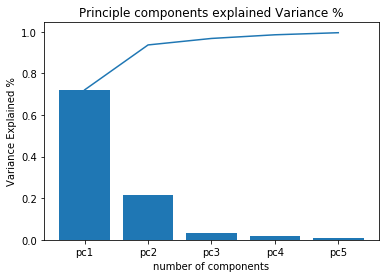

In [27]:
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('Variance Explained %');
plt.title('Principle components explained Variance %')
names=['pc1','pc2','pc3','pc4','pc5',]
l=list(range(len(pca.explained_variance_ratio_)))
plt.bar(names,pca.explained_variance_ratio_)

<Figure size 864x864 with 0 Axes>

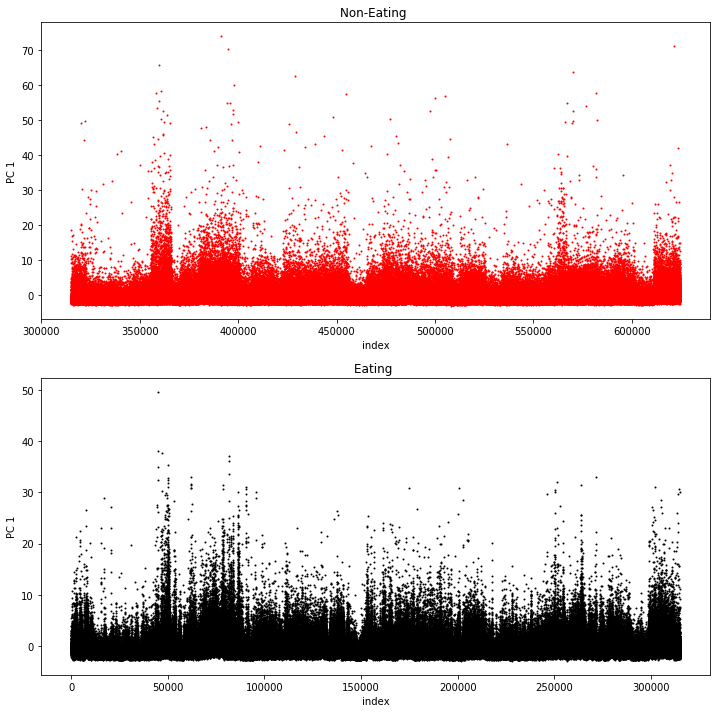

In [28]:
plt.figure(figsize=(12,12))
halfway_idx=int(630268/2)
pca_df_eat=pca_df.iloc[:halfway_idx,:]
pca_df_not_eat=pca_df.iloc[halfway_idx:,:]



fig,axes=plt.subplots(nrows=2,figsize=(12,12))
axes[1].scatter(pca_df_eat.index,pca_df_eat['principal component 1'],s=1, color='k')
axes[0].scatter(pca_df_not_eat.index,pca_df_not_eat['principal component 1'],s=1, color='r')

axes[0].set(xlabel="index",ylabel='PC 1')
axes[1].set(xlabel="index",ylabel='PC 1')


#axes[0].legend([' NOT- EATING'])
#axes[1].legend([' EATING'])
axes[1].set_title('Eating ')
axes[0].set_title('Non-Eating ')

plt.show()

<Figure size 864x864 with 0 Axes>

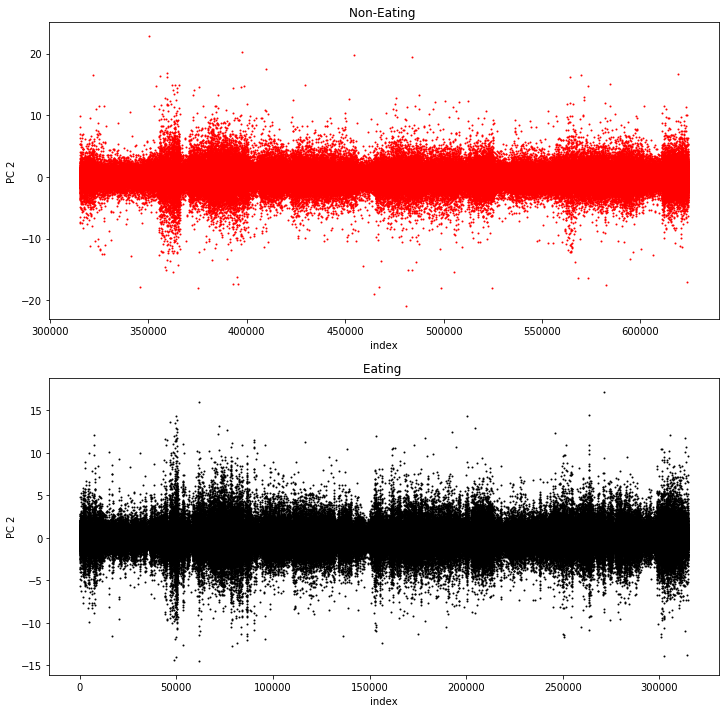

In [29]:
plt.figure(figsize=(12,12))
halfway_idx=int(630268/2)
pca_df_eat=pca_df.iloc[:halfway_idx,:]
pca_df_not_eat=pca_df.iloc[halfway_idx:,:]



fig,axes=plt.subplots(nrows=2,figsize=(12,12))
axes[1].scatter(pca_df_eat.index,pca_df_eat['principal component 2'],s=1, color='k')
axes[0].scatter(pca_df_not_eat.index,pca_df_not_eat['principal component 2'],s=1, color='r')

axes[0].set(xlabel="index",ylabel='PC 2')
axes[1].set(xlabel="index",ylabel='PC 2')


#axes[0].legend([' NOT- EATING'])
#axes[1].legend([' EATING'])
axes[1].set_title('Eating ')
axes[0].set_title('Non-Eating ')

plt.show()

In [ ]:
from sklearn.model_selection import train_test_split
    